In [ ]:
!pip install opencv-contrib-python
!pip install imutils
!pip install selectivesearch

  Preparing metadata (setup.py) ... done
  Created wheel for selectivesearch: filename=selectivesearch-0.4-py3-none-any.whl size=4335 sha256=2055c7f3a70c934a679b773ff8b679bd41a8d16e1e29b22d7b93240047c6351f
  Stored in directory: /root/.cache/pip/wheels/0e/49/95/01447a4e0f48a135ac91fbdb1dd2a1c0523e40e29957b383a3
Successfully built selectivesearch


In [ ]:
import numpy as np
import cv2

from tensorflow.keras.applications import VGG16, MobileNetV2
from tensorflow.keras.applications import imagenet_utils
from tensorflow.keras.applications.vgg16 import preprocess_input, decode_predictions
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.models import Model

from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from skimage.segmentation import felzenszwalb
from skimage.io import imread

from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions

from imutils.object_detection import non_max_suppression
import argparse
import selectivesearch

edit scale parameter below to get distinct separation between objects

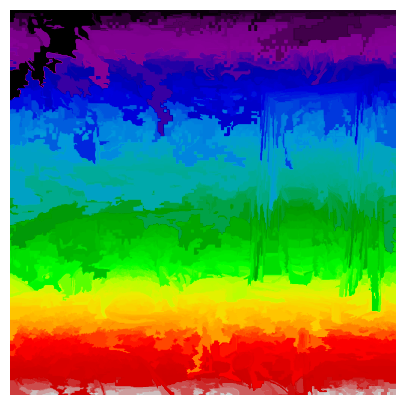

In [ ]:
image = imread('./mirror.jpg')
segments_fz = felzenszwalb(image, scale=50, sigma=0.5, min_size=50)

plt.figure(figsize=(10, 5))
plt.imshow(segments_fz, cmap='nipy_spectral')
plt.axis('off')
plt.show()
plt.imsave('low_scale.png', segments_fz, cmap='nipy_spectral')

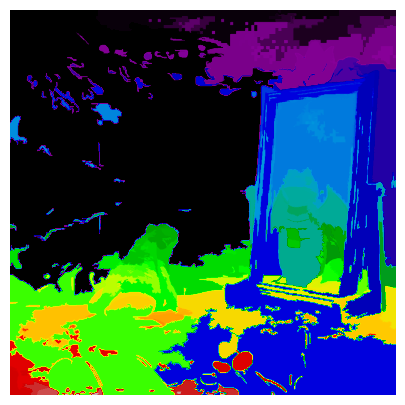

In [ ]:
image = imread('./mirror.jpg')
segments_fz = felzenszwalb(image, scale=500, sigma=0.5, min_size=50)

plt.figure(figsize=(10, 5))
plt.imshow(segments_fz, cmap='nipy_spectral')
plt.axis('off')
plt.show()
plt.imsave('mid_scale.png', segments_fz, cmap='nipy_spectral')

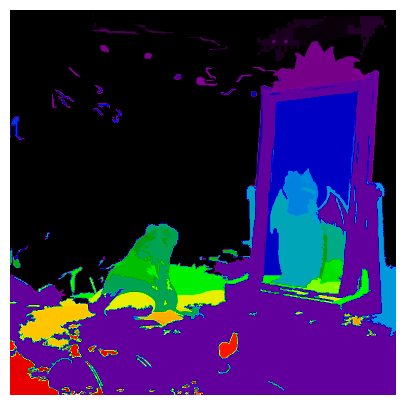

In [ ]:
image = imread('./mirror.jpg')
segments_fz = felzenszwalb(image, scale=1000, sigma=0.5, min_size=50)

plt.figure(figsize=(10, 5))
plt.imshow(segments_fz, cmap='nipy_spectral')
plt.axis('off')
plt.show()
plt.imsave('high_scale.png', segments_fz, cmap='nipy_spectral')

In [ ]:
base_model = VGG16(weights="imagenet")
model = Model(inputs=base_model.input, outputs=base_model.get_layer("fc1").output)

def detect_object(image):
    image = cv2.resize(image, (224, 224))
    image = np.expand_dims(img_to_array(image), axis=0)
    image = preprocess_input(image)

    features = model.predict(image)
    return features

553467096/553467096 [==============================] - 3s 0us/step


In [ ]:
image = cv2.imread("./mirror.jpg")

ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()
ss.setBaseImage(image)

ss.switchToSelectiveSearchFast()
rects = ss.process()

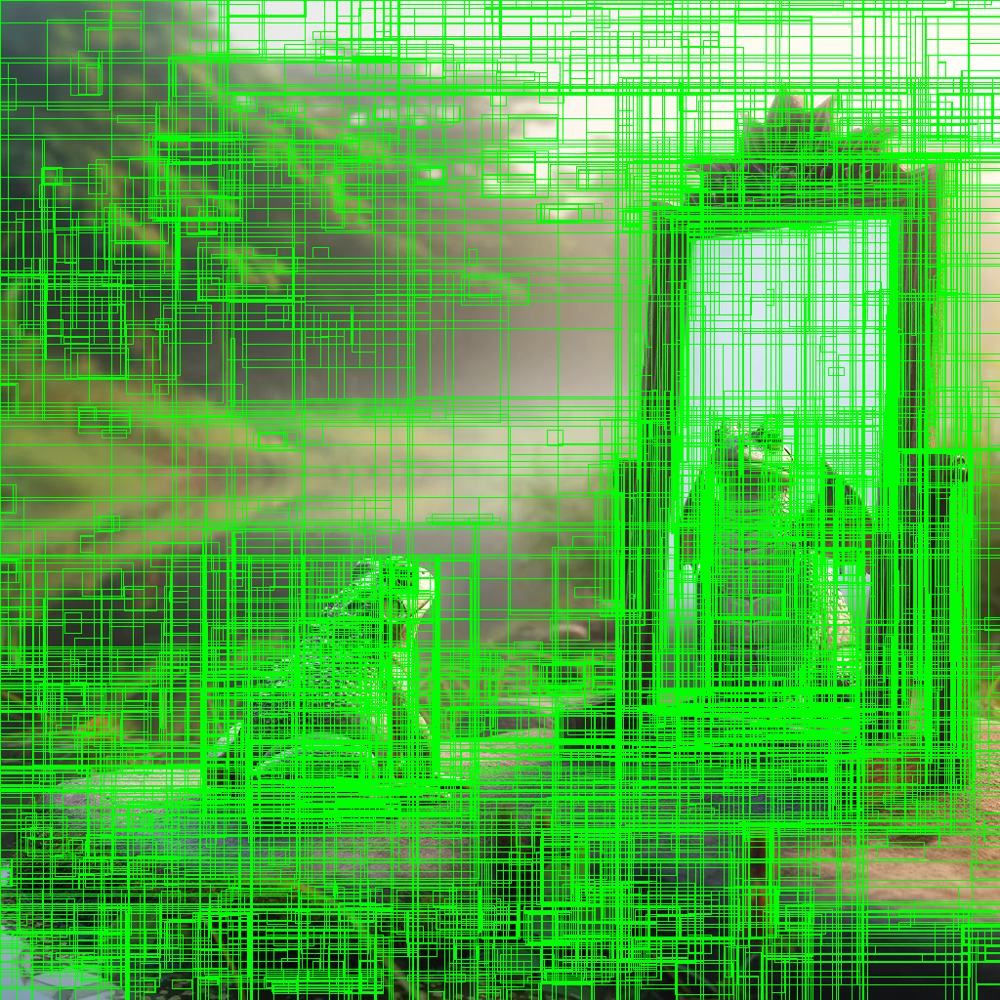

True

In [ ]:
for (x, y, w, h) in rects:
    cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 1)

cv2_imshow(image)
filename = "Initial_segmentation.png"
cv2.imwrite(filename, image)

In [ ]:
#model = VGG16(weights="imagenet")
model = ResNet50(weights="imagenet")

image = cv2.imread('./mirror.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
(H, W) = image.shape[:2]

ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()
ss.setBaseImage(image)
ss.switchToSelectiveSearchFast()
rects = ss.process()

102967424/102967424 [==============================] - 1s 0us/step


In [ ]:
rects_np = np.array([[x, y, x+w, y+h] for (x, y, w, h) in rects])
picked_boxes = non_max_suppression(rects_np, probs=None, overlapThresh=0.5)

labels = {}

for (startX, startY, endX, endY) in picked_boxes:
    roi = image[startY:endY, startX:endX]
    roi = cv2.resize(roi, (224, 224))
    roi = img_to_array(roi)
    roi = preprocess_input(roi)
    roi = np.expand_dims(roi, axis=0)

    preds = model.predict(roi)
    label, prob = decode_predictions(preds)[0][0][1:3]

    #if prob >= 0.3:
    if label not in labels:
            labels[label] = []
    labels[label].append(((startX, startY, endX, endY), prob))

1/1 [==============================] - 0s 348ms/step


[INFO] showing results for 'yellow_lady's_slipper'


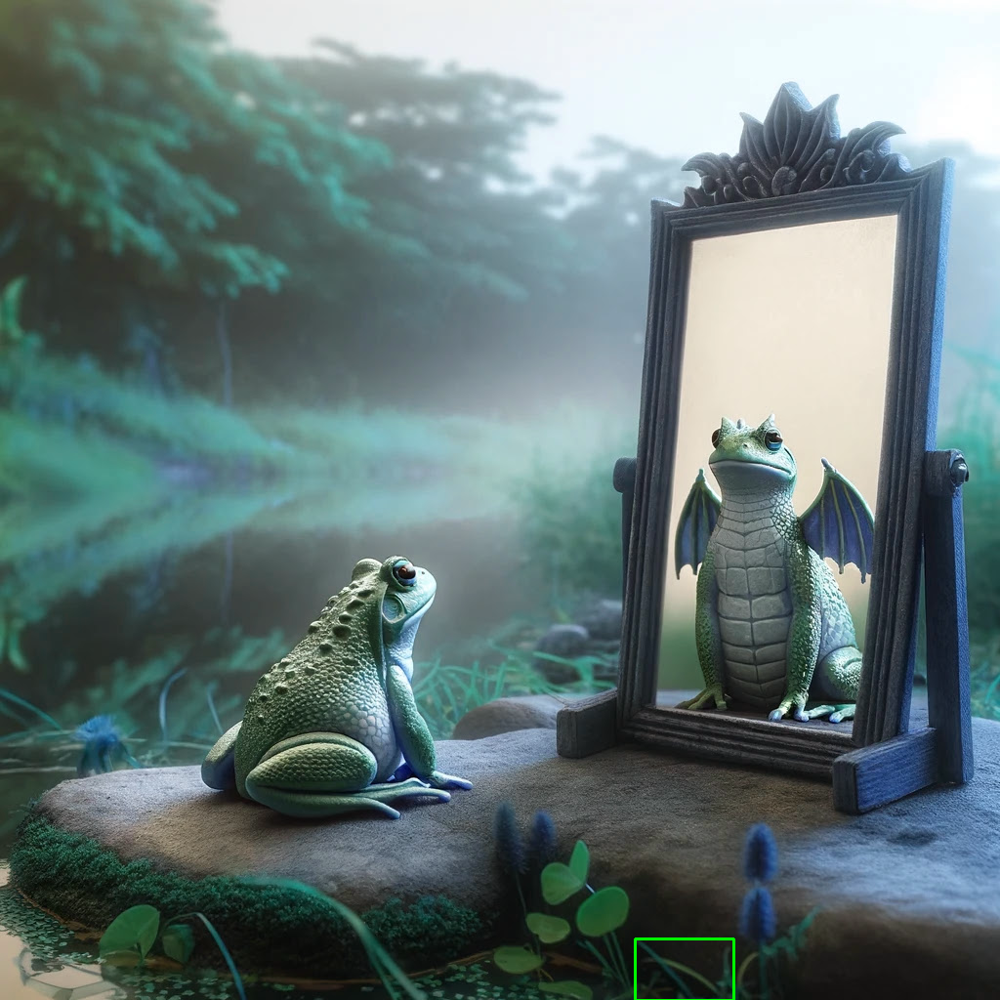

[INFO] Image saved as: yellow_lady's_slipper_before_nms_results.png
[INFO] showing results for 'ox'


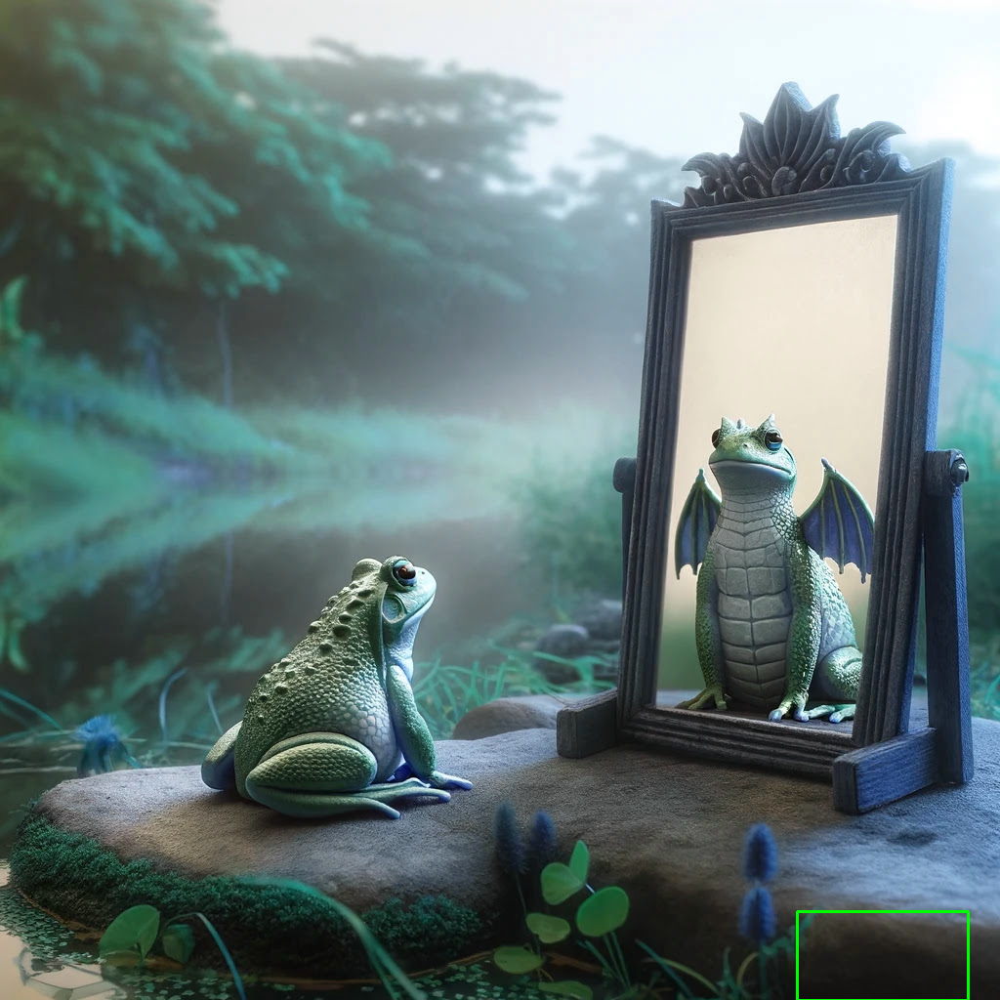

[INFO] Image saved as: ox_before_nms_results.png
[INFO] showing results for 'pot'


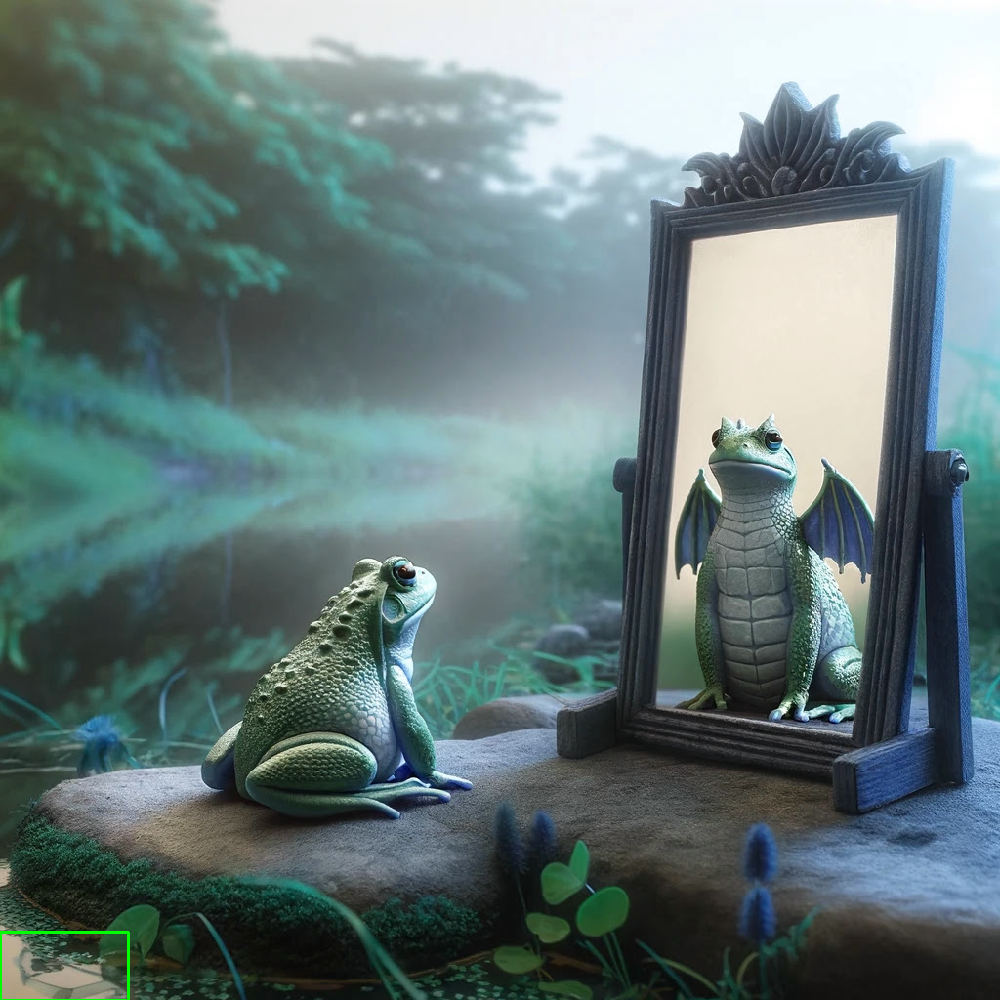

[INFO] Image saved as: pot_before_nms_results.png
[INFO] showing results for 'fountain'


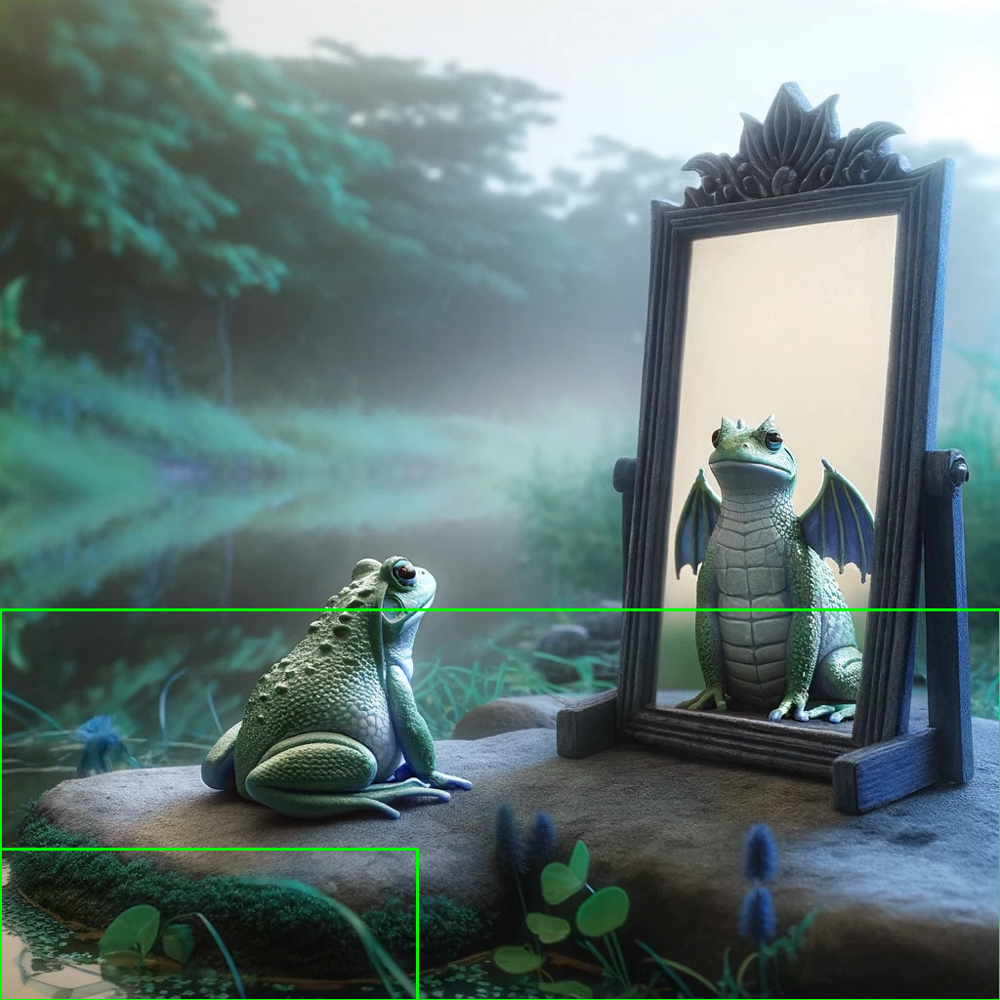

[INFO] Image saved as: fountain_before_nms_results.png
[INFO] showing results for 'bullfrog'


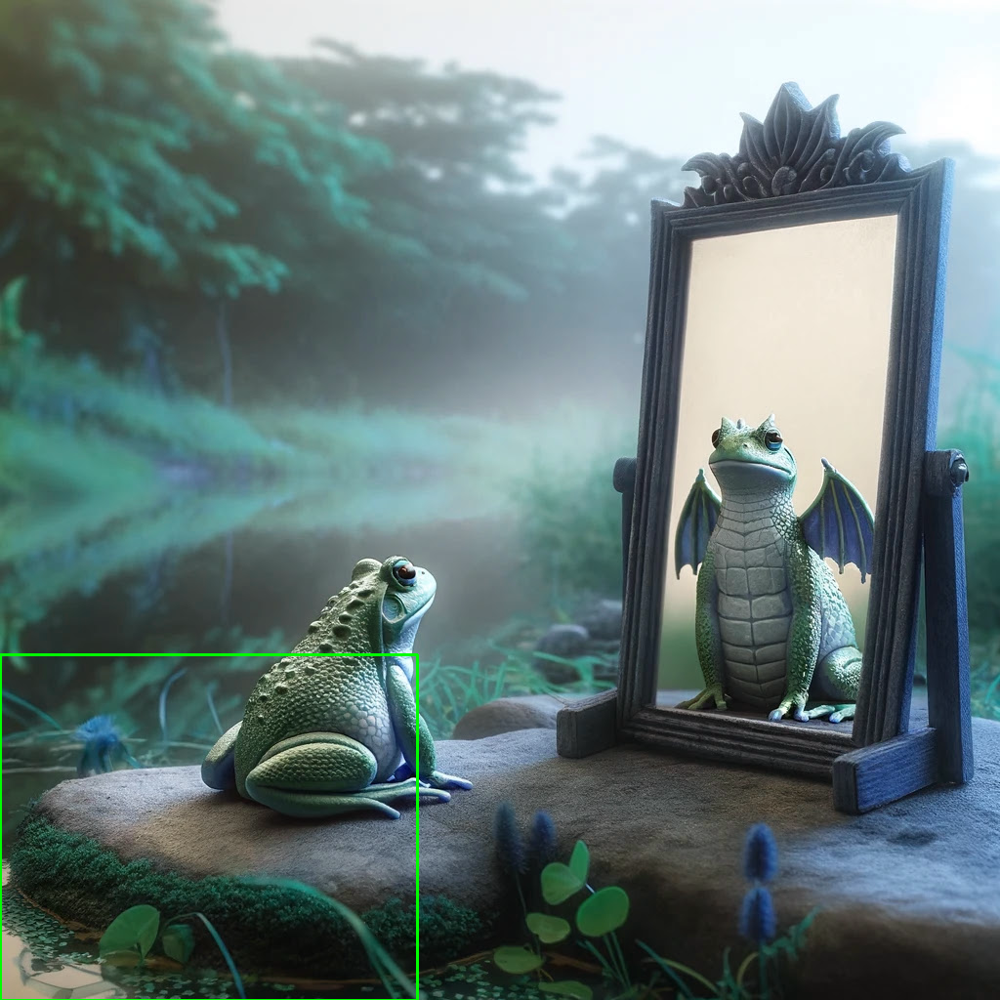

[INFO] Image saved as: bullfrog_before_nms_results.png
[INFO] showing results for 'television'


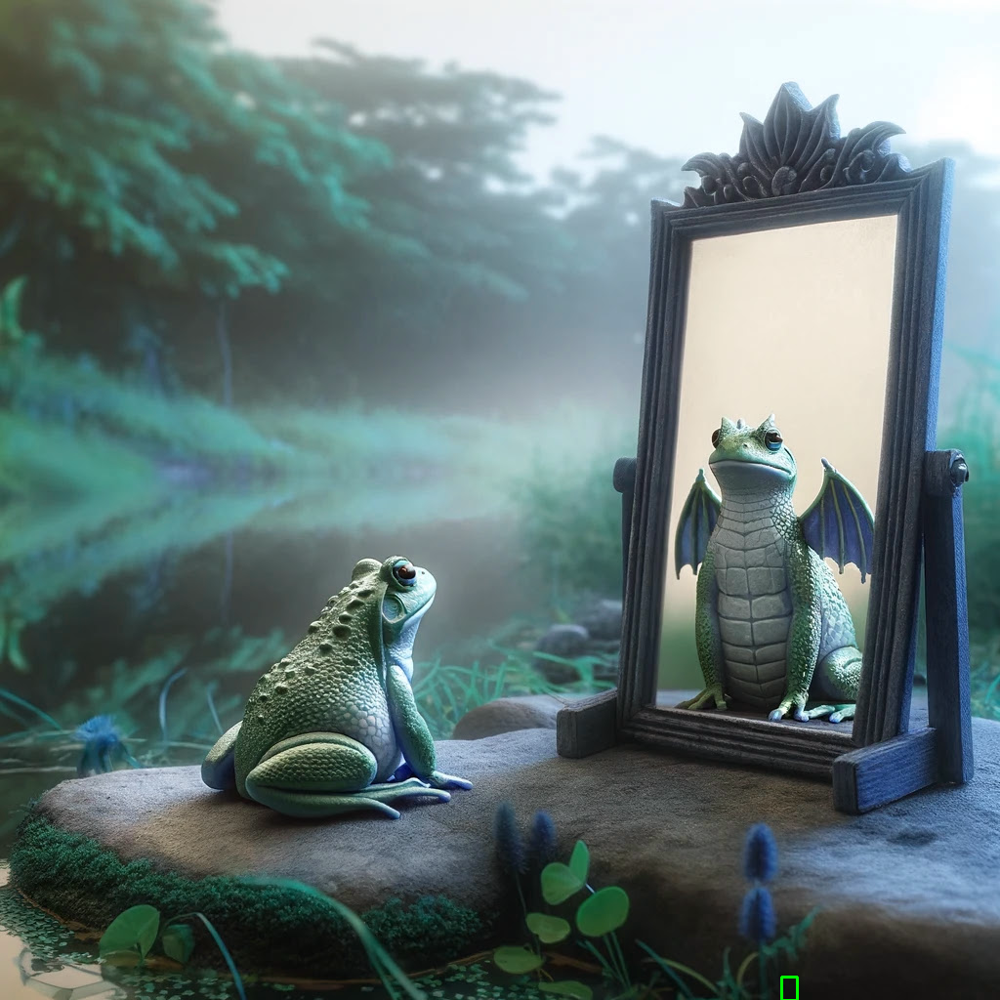

[INFO] Image saved as: television_before_nms_results.png
[INFO] showing results for 'sea_lion'


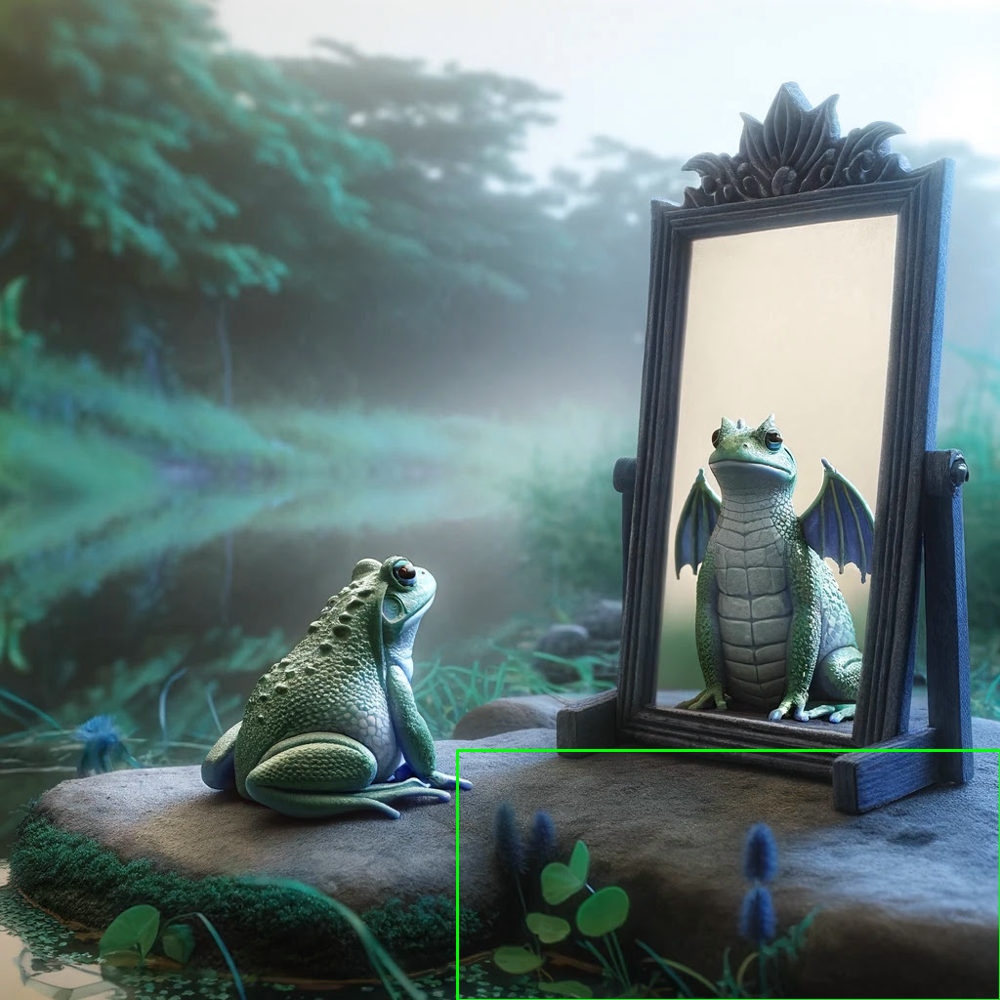

[INFO] Image saved as: sea_lion_before_nms_results.png
[INFO] showing results for 'Komodo_dragon'


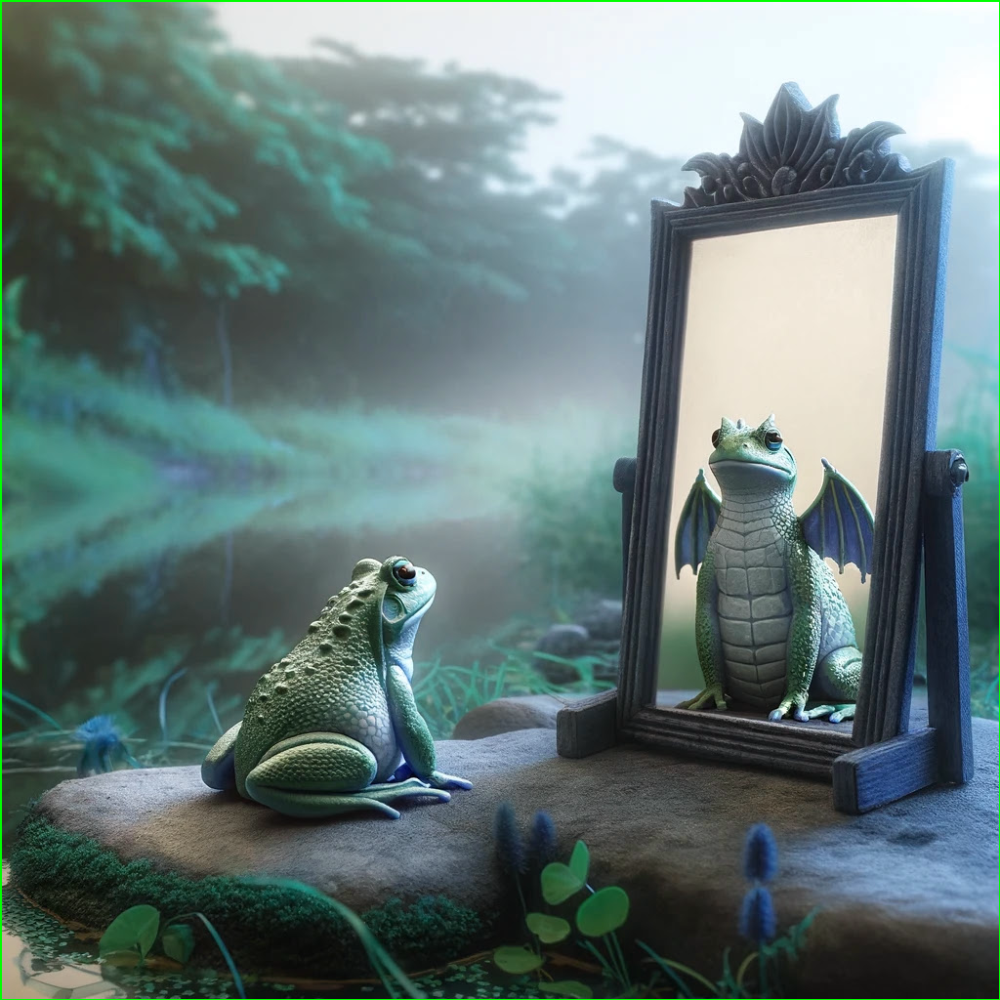

[INFO] Image saved as: Komodo_dragon_before_nms_results.png


In [ ]:
for label in labels.keys():
    print("[INFO] showing results for '{}'".format(label))
    clone = image.copy()

    for (box, prob) in labels[label]:
        (startX, startY, endX, endY) = box
        cv2.rectangle(clone, (startX, startY), (endX, endY), (0, 255, 0), 2)

    cv2_imshow(clone)

    filename = f"{label}_before_nms_results.png"
    cv2.imwrite(filename, clone)
    print("[INFO] Image saved as:", filename)

[INFO] showing results for 'yellow_lady's_slipper'


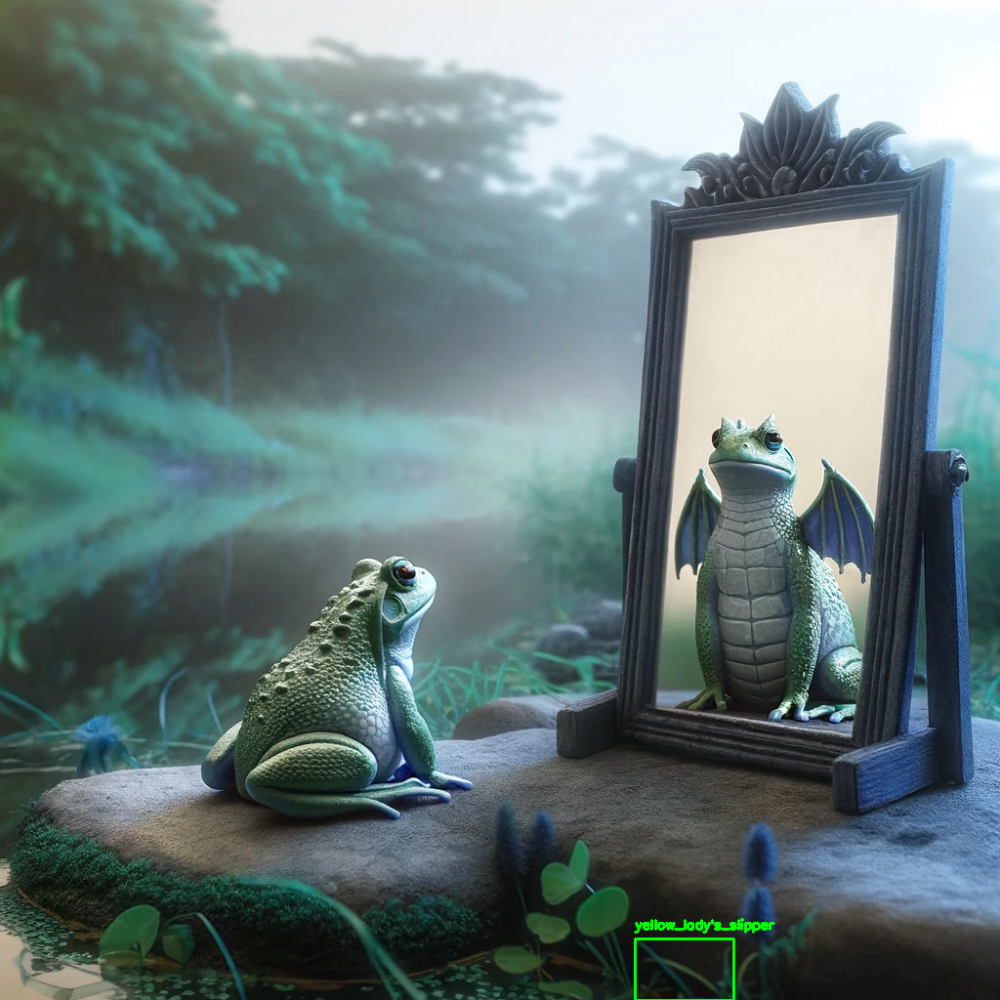

[INFO] showing results for 'ox'


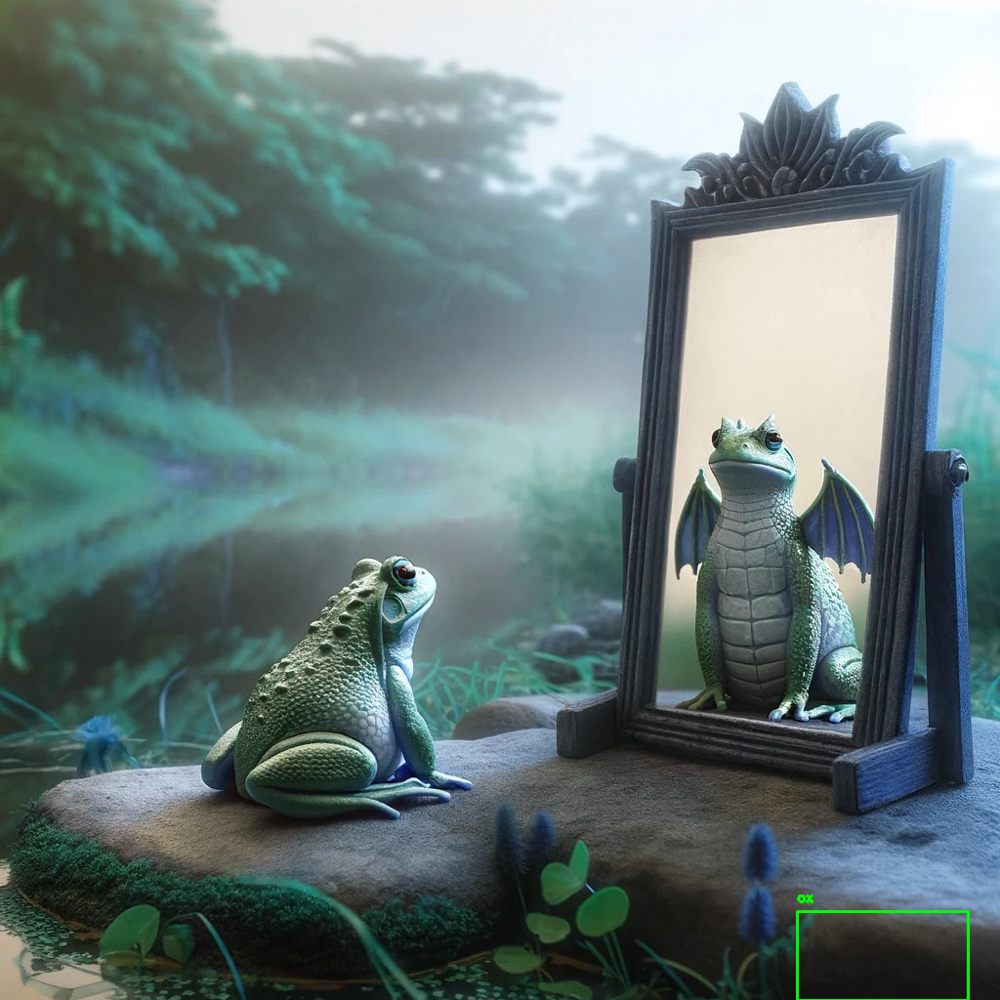

[INFO] showing results for 'pot'


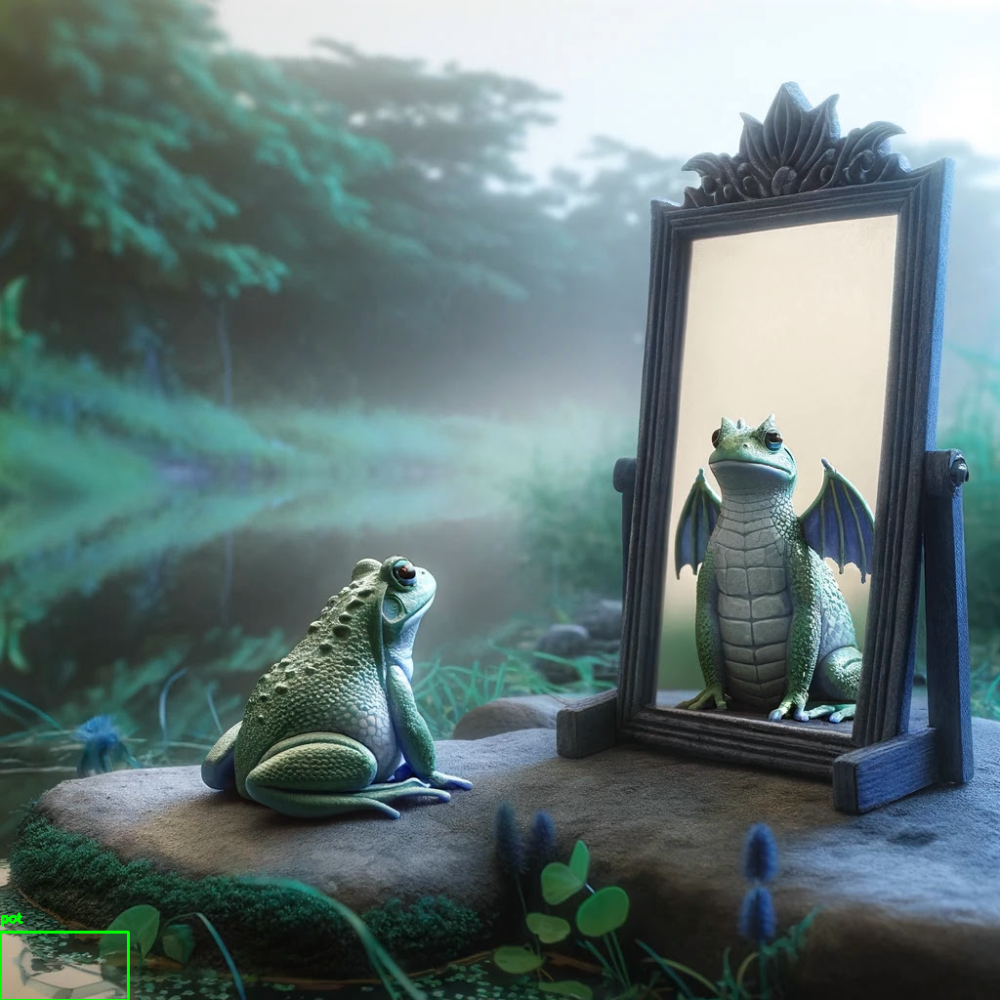

[INFO] showing results for 'fountain'


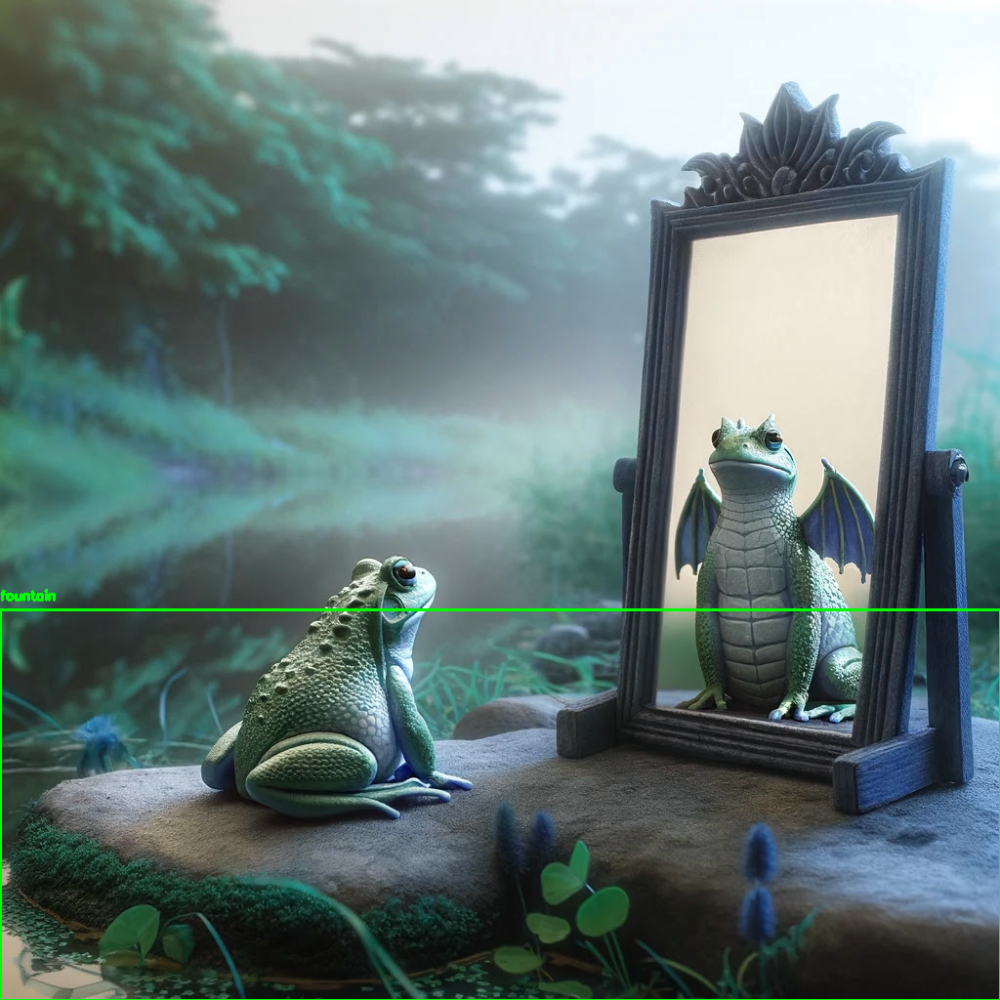

[INFO] showing results for 'bullfrog'


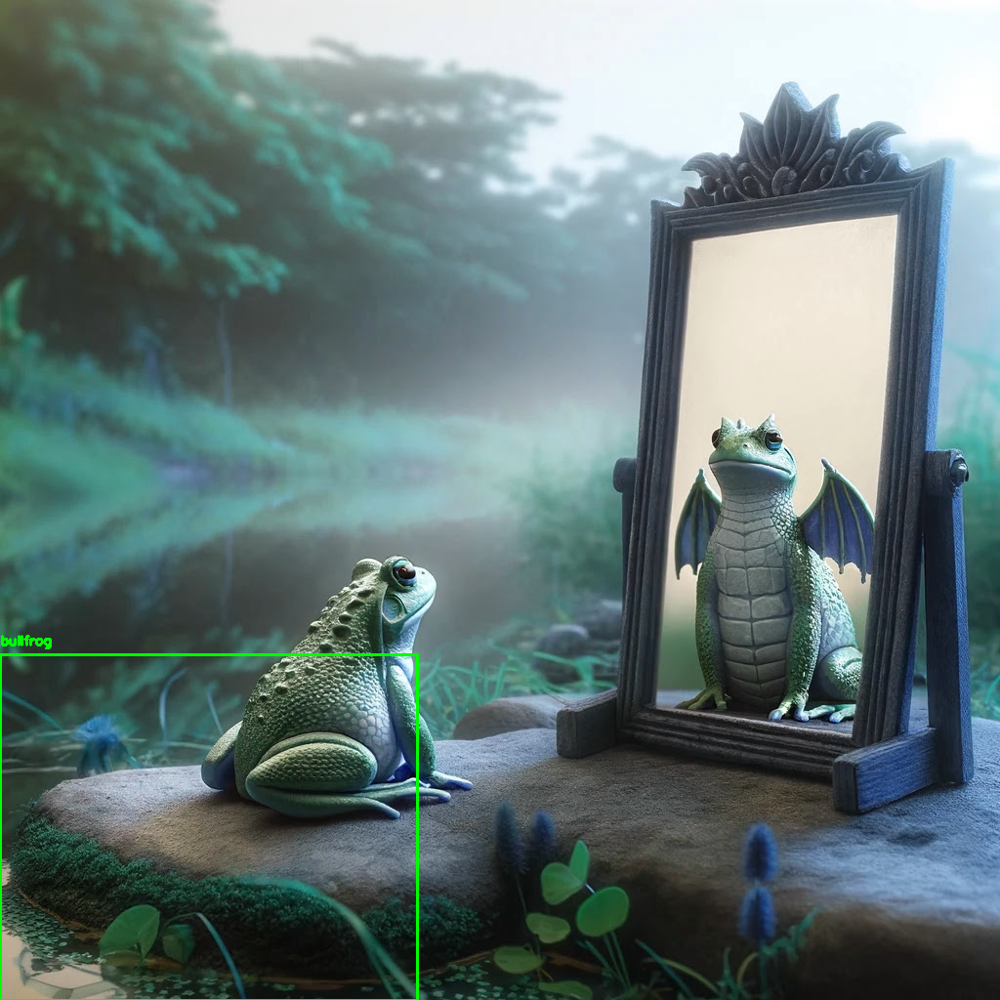

[INFO] showing results for 'television'


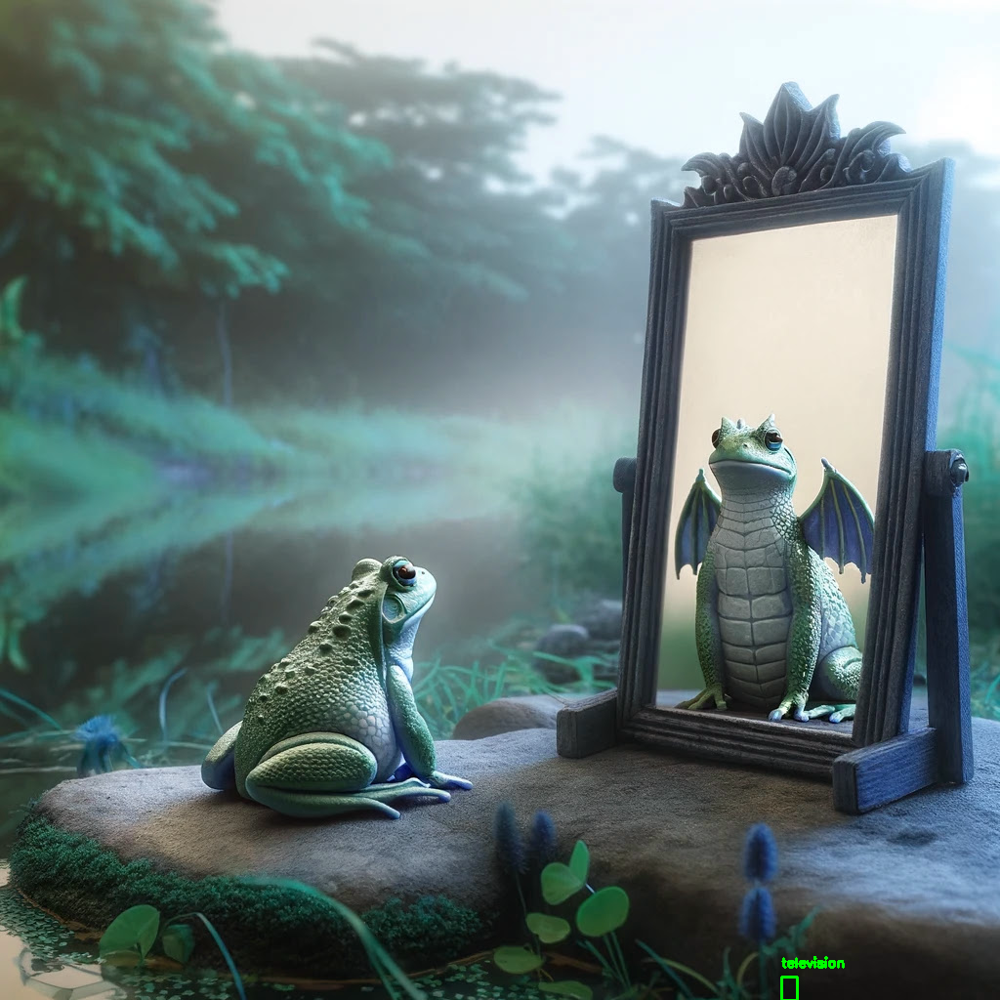

[INFO] showing results for 'sea_lion'


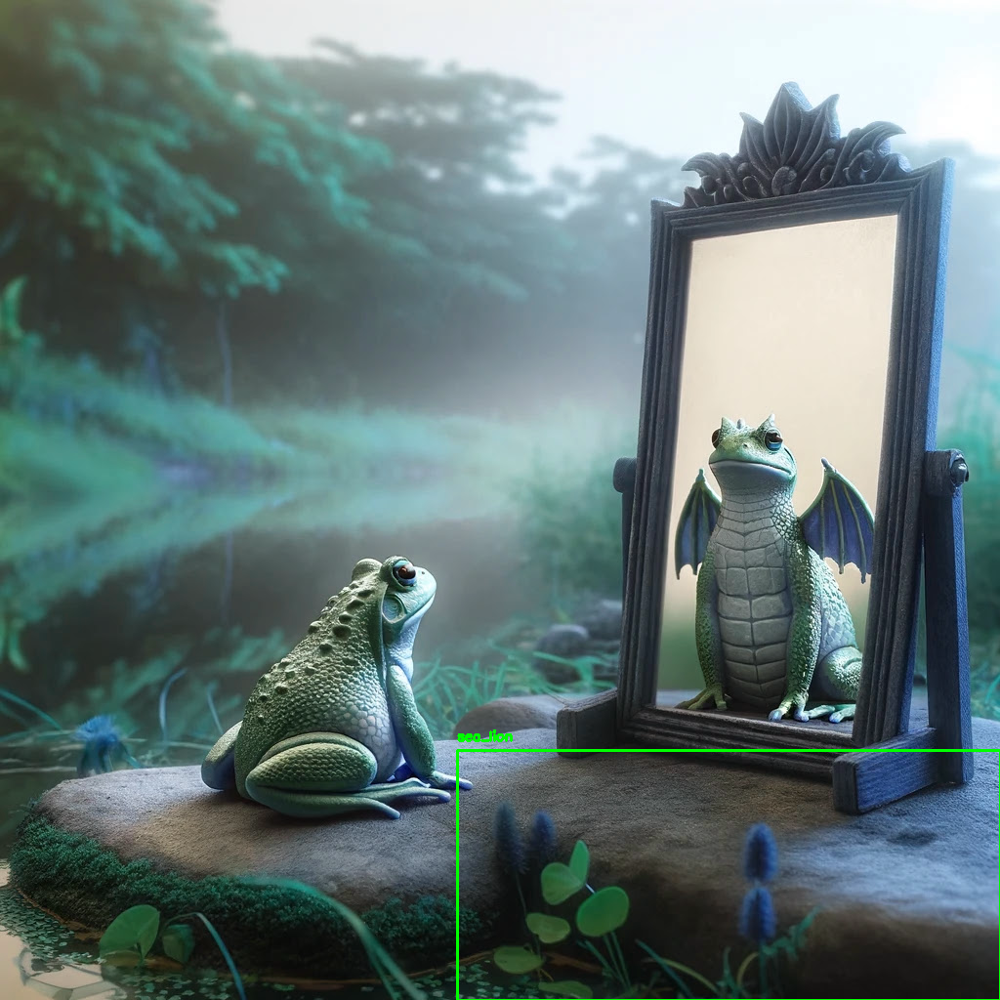

[INFO] showing results for 'Komodo_dragon'


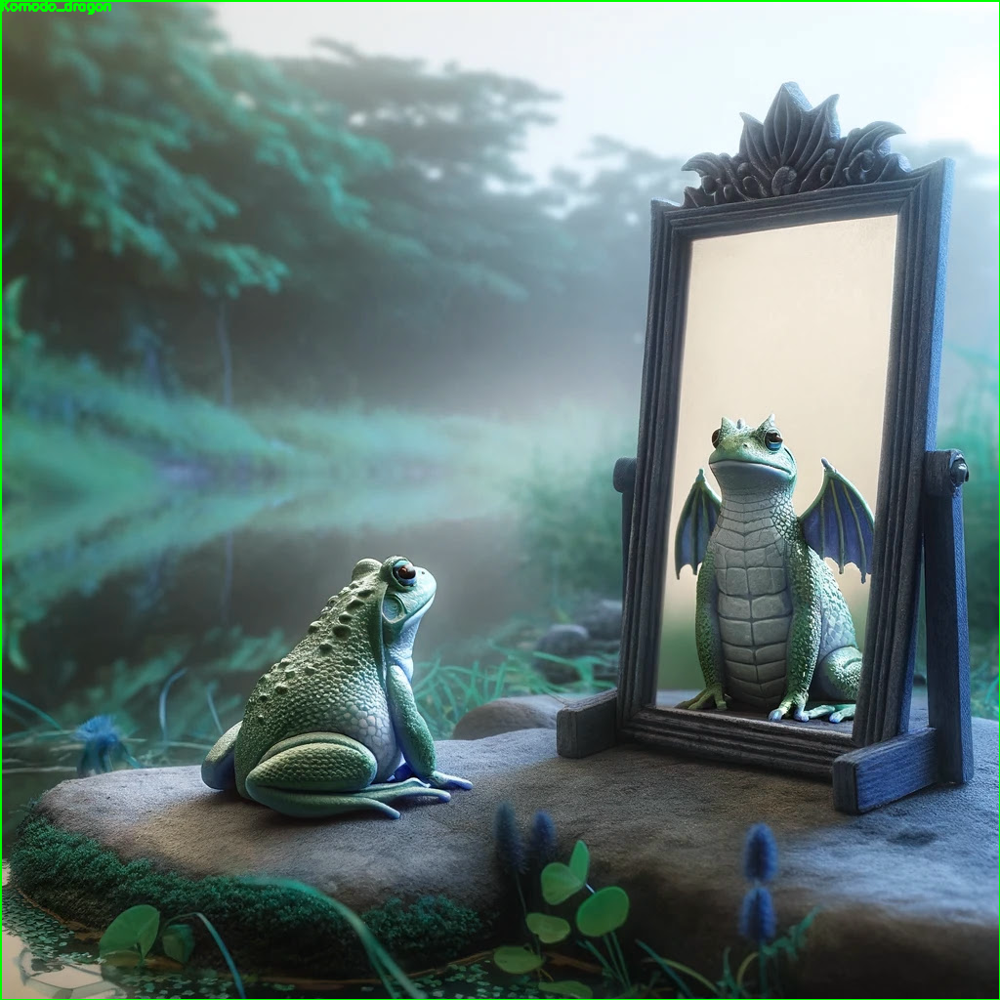

In [ ]:
for label in labels.keys():
    print("[INFO] showing results for '{}'".format(label))
    clone = image.copy()

    boxes = np.array([p[0] for p in labels[label]])
    proba = np.array([p[1] for p in labels[label]])
    boxes = non_max_suppression(boxes, proba)

    for (startX, startY, endX, endY) in boxes:
        cv2.rectangle(clone, (startX, startY), (endX, endY),
                      (0, 255, 0), 2)

        y = startY - 10 if startY - 10 > 10 else startY + 10
        cv2.putText(clone, label, (startX, y),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.45, (0, 255, 0), 2)

    cv2_imshow(clone)
    filename = f"{label}_after_nms_results.png"
    cv2.imwrite(filename, clone)